In [1]:
import sklearn
from sklearn import datasets
import sys
import numpy as np
import os
import glob
from PIL import Image 
from tkinter import Tcl
from skimage.feature import local_binary_pattern
from sklearn.preprocessing import normalize
import matplotlib.pyplot as plt
import PIL
from skimage.io import imread
from skimage.io import imread
from skimage.transform import resize
from skimage.feature import hog
from skimage import exposure
import matplotlib.image as img 
import scipy.stats as stats
import csv
from scipy.spatial.distance import cityblock
from scipy.spatial import distance


# Task 0

## Downloading the Data

In [2]:
sklearn.datasets.fetch_olivetti_faces(data_home=None, shuffle=False, random_state=0, download_if_missing=True)
data= sklearn.datasets.fetch_olivetti_faces(data_home=None, shuffle=False, random_state=0, download_if_missing=True)
data

{'data': array([[0.30991736, 0.3677686 , 0.41735536, ..., 0.15289256, 0.16115703,
         0.1570248 ],
        [0.45454547, 0.47107437, 0.5123967 , ..., 0.15289256, 0.15289256,
         0.15289256],
        [0.3181818 , 0.40082645, 0.49173555, ..., 0.14049587, 0.14876033,
         0.15289256],
        ...,
        [0.5       , 0.53305787, 0.607438  , ..., 0.17768595, 0.14876033,
         0.19008264],
        [0.21487603, 0.21900827, 0.21900827, ..., 0.57438016, 0.59090906,
         0.60330576],
        [0.5165289 , 0.46280992, 0.28099173, ..., 0.35950413, 0.3553719 ,
         0.38429752]], dtype=float32),
 'images': array([[[0.30991736, 0.3677686 , 0.41735536, ..., 0.37190083,
          0.3305785 , 0.30578512],
         [0.3429752 , 0.40495867, 0.43801653, ..., 0.37190083,
          0.338843  , 0.3140496 ],
         [0.3429752 , 0.41735536, 0.45041323, ..., 0.38016528,
          0.338843  , 0.29752067],
         ...,
         [0.21487603, 0.20661157, 0.2231405 , ..., 0.15289256,
     

In [3]:
np.set_printoptions(threshold = sys.maxsize)

In [4]:
file_list = os.listdir("Downloads/images/")  #getting the directory
def last_4chars(x):
    return(x[:-6])

img_ordered=sorted(file_list, key = last_4chars) #getting image Id and sorting


In [5]:
def getImageData(dir)n
    global images
    images=[]
    image_data=[]
    global n                  #stores number of images
    n=0
    for img in glob.glob(dir):
        images.append(img)
        n=n+1

    images = natsorted(images)
    
    for imagename in images:

        img= Image.open(imagename)
        
        image = np.asarray(img)
        image_data.append(image)
        
        
    image_data=np.true_divide(image_data,255) 
    return image_data,images

In [6]:



from natsort import natsorted
dir_name="Downloads/images/*.png"

i=0

image_data,dat1=getImageData(dir_name)   
print(image_data)


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [7]:
ID={}
i=int(0)
for x in img_ordered:
    ID[i]=x
    i=i+1
ID

{0: 'image-0.png',
 1: 'image-1.png',
 2: 'image-2.png',
 3: 'image-3.png',
 4: 'image-4.png',
 5: 'image-5.png',
 6: 'image-6.png',
 7: 'image-7.png',
 8: 'image-8.png',
 9: 'image-9.png',
 10: 'image-10.png',
 11: 'image-11.png',
 12: 'image-12.png',
 13: 'image-13.png',
 14: 'image-14.png',
 15: 'image-15.png',
 16: 'image-16.png',
 17: 'image-17.png',
 18: 'image-18.png',
 19: 'image-19.png',
 20: 'image-20.png',
 21: 'image-21.png',
 22: 'image-22.png',
 23: 'image-23.png',
 24: 'image-24.png',
 25: 'image-25.png',
 26: 'image-26.png',
 27: 'image-27.png',
 28: 'image-28.png',
 29: 'image-29.png',
 30: 'image-30.png',
 31: 'image-31.png',
 32: 'image-32.png',
 33: 'image-33.png',
 34: 'image-34.png',
 35: 'image-35.png',
 36: 'image-36.png',
 37: 'image-37.png',
 38: 'image-38.png',
 39: 'image-39.png',
 40: 'image-40.png',
 41: 'image-41.png',
 42: 'image-42.png',
 43: 'image-43.png',
 44: 'image-44.png',
 45: 'image-45.png',
 46: 'image-46.png',
 47: 'image-47.png',
 48: 'image-

# Task 1


## Spliting the Images

In [8]:
def splitting(p):
    arr= []
    for i in range(n):
        arr.append([np.hsplit(x, 8) for x in np.vsplit(p[i],8)])
    return arr
    
    

In [9]:

block_array=[]

block_array.append(splitting(image_data))
block_array=np.reshape(block_array,(400,64,8,8))

In [10]:
block_array

array([[[[0.28627451, 0.36078431, 0.42352941, 0.45490196, 0.56078431,
          0.6627451 , 0.7254902 , 0.74901961],
         [0.32941176, 0.40784314, 0.44705882, 0.49019608, 0.59215686,
          0.68235294, 0.74117647, 0.76078431],
         [0.32941176, 0.42352941, 0.4627451 , 0.54117647, 0.61960784,
          0.70980392, 0.74901961, 0.76470588],
         [0.28235294, 0.41176471, 0.49019608, 0.55686275, 0.64705882,
          0.71764706, 0.74509804, 0.74901961],
         [0.31764706, 0.42745098, 0.49411765, 0.63137255, 0.70196078,
          0.73333333, 0.73333333, 0.74509804],
         [0.29019608, 0.39215686, 0.49411765, 0.66666667, 0.71764706,
          0.71764706, 0.73333333, 0.72941176],
         [0.28627451, 0.36862745, 0.56862745, 0.71764706, 0.7254902 ,
          0.70980392, 0.71764706, 0.70980392],
         [0.22745098, 0.35294118, 0.6       , 0.71764706, 0.70980392,
          0.69411765, 0.69803922, 0.70980392]],

        [[0.76470588, 0.76078431, 0.78039216, 0.77647059, 0.77

In [11]:
print(block_array.shape)

(400, 64, 8, 8)


## Finding Color Moments

In [12]:
#function to find color moment
def cm(y):
    cm_m=np.mean(y)
    cm_sd=np.std(y)
    total=0
    for p in range(8):
        for q in range(8):
            total=total+pow((y[p][q]-cm_m),3)
    total=total/64
    total=pow(abs(total),float(1)/3) * (1,-1)[total<0]
    cm_sk= total
    return cm_m,cm_sd,cm_sk
    
    

In [13]:

mean=np.zeros((n,64))
sd=np.zeros((n,64))
sk=np.zeros((n,64))
cm_v=np.zeros((n,64,3))
p=0
q=0
print(image_data.shape)
for i in range(len(image_data)):
    for j in range(len(image_data[i])):
        mean[i][j],sd[i][j],sk[i][j]=cm(block_array[i][j])#finding mean,sd, skewness for entire dataset

        

(400, 64, 64)


C:\Users\Fenil\anaconda3\lib\site-packages\ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':


In [14]:
mean  

array([[0.57677696, 0.7689951 , 0.79969363, 0.87659314, 0.84001225,
        0.79748775, 0.79485294, 0.52438725, 0.58308824, 0.70318627,
        0.65484069, 0.81832108, 0.79393382, 0.61636029, 0.68780637,
        0.53339461, 0.71985294, 0.68511029, 0.58082108, 0.72696078,
        0.72751225, 0.60453431, 0.60968137, 0.66930147, 0.7533701 ,
        0.77757353, 0.76770833, 0.7526348 , 0.78045343, 0.71617647,
        0.74699755, 0.72481618, 0.73002451, 0.85496324, 0.80441176,
        0.7721201 , 0.74681373, 0.78854167, 0.8153799 , 0.68045343,
        0.49209559, 0.90324755, 0.82291667, 0.7348652 , 0.7245098 ,
        0.82334559, 0.83443627, 0.45435049, 0.24822304, 0.89025735,
        0.77506127, 0.62855392, 0.58345588, 0.7466299 , 0.76636029,
        0.29601716, 0.19375   , 0.78229167, 0.86268382, 0.78884804,
        0.75128676, 0.75165441, 0.64932598, 0.29969363],
       [0.75477941, 0.83590686, 0.88535539, 0.9185049 , 0.85416667,
        0.82512255, 0.77530637, 0.25490196, 0.82089461, 0.7

In [15]:
sd

array([[0.16276179, 0.01769762, 0.01449696, 0.02531016, 0.03387095,
        0.01721094, 0.02054003, 0.16820437, 0.16439904, 0.08627416,
        0.11605022, 0.03348477, 0.03363424, 0.10613069, 0.10643153,
        0.19172808, 0.1089733 , 0.15258518, 0.10418049, 0.07001915,
        0.09974013, 0.07978374, 0.14477469, 0.11588769, 0.05898718,
        0.02303889, 0.046051  , 0.03431586, 0.04558292, 0.04108007,
        0.0298818 , 0.05552671, 0.18996881, 0.0280184 , 0.03092123,
        0.06860335, 0.08417075, 0.04558721, 0.02355294, 0.12600994,
        0.33192681, 0.01752483, 0.0397707 , 0.05345438, 0.03831691,
        0.03136818, 0.02438664, 0.28550449, 0.24788385, 0.0491884 ,
        0.12738755, 0.13536775, 0.12220632, 0.10353382, 0.06599214,
        0.23887793, 0.14669681, 0.05788878, 0.03711592, 0.04773925,
        0.04119867, 0.05737621, 0.05548017, 0.26652769],
       [0.10774498, 0.01913924, 0.02805483, 0.02500931, 0.01344023,
        0.0168062 , 0.0426368 , 0.16507603, 0.03804032, 0.1

In [16]:
sk

array([[-1.33398394e-01, -1.58036595e-02,  1.07109401e-02,
        -2.05462318e-02, -1.94571053e-02, -1.85346645e-02,
        -2.04276867e-02, -9.40625448e-02, -1.73856261e-01,
        -8.07186818e-02, -1.22640492e-01, -3.26439643e-02,
        -3.09503212e-02, -8.62136694e-02, -1.36740512e-01,
        -1.93117960e-01, -1.42922408e-01, -1.22192690e-01,
        -1.08597474e-01, -6.59776166e-02, -7.49252797e-02,
        -6.49600812e-02, -1.53077356e-01, -1.61126033e-01,
        -4.38979493e-02,  8.32726861e-03,  3.03466031e-02,
        -3.07216232e-02, -4.53530177e-02,  1.64225332e-02,
        -2.25496763e-02, -4.86623217e-02, -2.56272557e-01,
        -1.79700665e-02, -4.22449175e-02, -4.75298477e-02,
        -7.65407167e-02, -5.18573913e-02, -5.69381427e-03,
        -1.72698587e-01, -1.66399336e-01, -1.16348276e-02,
        -2.94625985e-02, -2.54891591e-02,  1.49775223e-02,
        -3.10420113e-02, -2.33873707e-02, -1.69733994e-01,
         2.82959233e-01, -6.31128974e-02, -1.17755965e-0

In [17]:
sd.shape

(400, 64)

In [18]:
sd

array([[0.16276179, 0.01769762, 0.01449696, 0.02531016, 0.03387095,
        0.01721094, 0.02054003, 0.16820437, 0.16439904, 0.08627416,
        0.11605022, 0.03348477, 0.03363424, 0.10613069, 0.10643153,
        0.19172808, 0.1089733 , 0.15258518, 0.10418049, 0.07001915,
        0.09974013, 0.07978374, 0.14477469, 0.11588769, 0.05898718,
        0.02303889, 0.046051  , 0.03431586, 0.04558292, 0.04108007,
        0.0298818 , 0.05552671, 0.18996881, 0.0280184 , 0.03092123,
        0.06860335, 0.08417075, 0.04558721, 0.02355294, 0.12600994,
        0.33192681, 0.01752483, 0.0397707 , 0.05345438, 0.03831691,
        0.03136818, 0.02438664, 0.28550449, 0.24788385, 0.0491884 ,
        0.12738755, 0.13536775, 0.12220632, 0.10353382, 0.06599214,
        0.23887793, 0.14669681, 0.05788878, 0.03711592, 0.04773925,
        0.04119867, 0.05737621, 0.05548017, 0.26652769],
       [0.10774498, 0.01913924, 0.02805483, 0.02500931, 0.01344023,
        0.0168062 , 0.0426368 , 0.16507603, 0.03804032, 0.1

In [19]:
sk.shape

(400, 64)

In [20]:
sk

array([[-1.33398394e-01, -1.58036595e-02,  1.07109401e-02,
        -2.05462318e-02, -1.94571053e-02, -1.85346645e-02,
        -2.04276867e-02, -9.40625448e-02, -1.73856261e-01,
        -8.07186818e-02, -1.22640492e-01, -3.26439643e-02,
        -3.09503212e-02, -8.62136694e-02, -1.36740512e-01,
        -1.93117960e-01, -1.42922408e-01, -1.22192690e-01,
        -1.08597474e-01, -6.59776166e-02, -7.49252797e-02,
        -6.49600812e-02, -1.53077356e-01, -1.61126033e-01,
        -4.38979493e-02,  8.32726861e-03,  3.03466031e-02,
        -3.07216232e-02, -4.53530177e-02,  1.64225332e-02,
        -2.25496763e-02, -4.86623217e-02, -2.56272557e-01,
        -1.79700665e-02, -4.22449175e-02, -4.75298477e-02,
        -7.65407167e-02, -5.18573913e-02, -5.69381427e-03,
        -1.72698587e-01, -1.66399336e-01, -1.16348276e-02,
        -2.94625985e-02, -2.54891591e-02,  1.49775223e-02,
        -3.10420113e-02, -2.33873707e-02, -1.69733994e-01,
         2.82959233e-01, -6.31128974e-02, -1.17755965e-0

## Extended Local Binary Pattern

In [21]:
def elbp(x):#function to find ELBP vector
    lbp_v=np.zeros((n,64,64))
    i=0
    for imagename in x:
        
        image=imagename/255
        lbp=local_binary_pattern(image,8,1,method='uniform')
        lbp_v[i]=lbp
        i=i+1        

    return lbp_v


## Histogram Oriented Grading


In [22]:
def hist(x):#function to find hog vector
    hog_v=np.zeros((n,3780))
    i=0
    for imagename in x:
        
        resized_img = resize(imagename, (128, 64))
        plt.axis("off")
        fd, hog_image = hog(resized_img, orientations=9, pixels_per_cell=(8, 8),cells_per_block=(2, 2), visualize=True, block_norm='L2-Hys')
        
        
        hog_v[i]=fd
        i=i+1
        #plt.imshow(hog_image)
        #plt.show()
    return hog_v
    

# TASK 2

C:\Users\Fenil\anaconda3\lib\site-packages\ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':


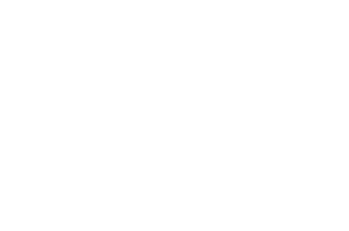

In [23]:
path='Downloads/images/*.png'

t2_data,dat1=getImageData(path)  #stores image data  
t2_data = np.squeeze(t2_data)
t2_split=splitting(t2_data)#splits each image into 8x8
t2_split=np.array(t2_split)
t2_split=np.reshape(t2_split,(n,64,8,8))
mean=np.zeros((n,64))
sd=np.zeros((n,64))
sk=np.zeros((n,64))
cm_v=np.zeros((n,64,3))

p=0
q=0

for i in range(len(image_data)):
    for j in range(len(image_data[i])):
        mean[i][j],sd[i][j],sk[i][j]=cm(t2_split[i][j])
        cm_v[i][j][0]=mean[i][j]
        cm_v[i][j][1]=sd[i][j]
        cm_v[i][j][2]=sk[i][j]
        
vector_hog=hist(t2_data)
vector_elbp=elbp(t2_data)


In [24]:

f = open('Downloads/out.csv', 'w')#creates output file
header=['Image ID','Image Name','Color Moments Vector','Elbp Vector','HOG Vector']

writer = csv.writer(f)

writer.writerow(header)#writes heading
for i in range(n):
    dat=[i,ID[i],cm_v[i],vector_elbp[i],vector_hog[i]]
    writer.writerow(dat)#writes rows




# Task 3

In [36]:
def cm_dis(x):#function to find cityblock distance between color moment vectors
    for i in range(len(x)):
        for j in range(len(x[i])):
            ti_m[i][j],ti_sd[i][j],ti_sk[i][j]=cm(ti_split[i][j])
    j=0
    for i in range(n):
            dis_cm[dat[i]]=cityblock(ti_m[0],ti_m[i])+cityblock(ti_sd[0],ti_sd[i])+cityblock(ti_sk[0],ti_sk[i])
            j=j+1
            
    
    
    return dis_cm

In [37]:
def elbp_dis(x):#function to find eucledean distance between elbp vectors
    lbp=elbp(x)
    j=0
    for i in range(n):
        dis_elbp[dat[i]]= np.linalg.norm(lbp[0]-lbp[i])
        j=j+1   
    return dis_elbp

In [38]:
def hog_dis(x):  #function to find eucledean distance between hog vectors
    hg=hist(x)
    j=0
    for i in range(n):
        dis_hog[dat[i]] = np.linalg.norm(hg[0]- hg[i])
        j=j+1
    return dis_hog
    

{'Downloads/set3\\image-110.png': 7.346059152402157, 'Downloads/set3\\image-130.png': 7.452610921785664, 'Downloads/set3\\image-100.png': 7.590557395714776, 'Downloads/set3\\image-120.png': 7.636524391452551}


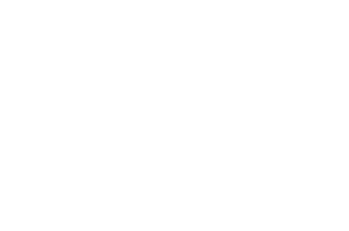

In [39]:


path='Downloads/set3/*.png'
k=4
model="hog"
ti_data,dat=getImageData(path)
    
ti_data = np.squeeze(ti_data)

ti_split=splitting(ti_data)
ti_split=np.array(ti_split)
ti_split=np.reshape(ti_split,(n,64,8,8))
i=0
ti_m=np.zeros((n,64))
ti_sd=np.zeros((n,64))
ti_sk=np.zeros((n,64))
dis_cm={}
dis_elbp={}
dis_hog={}



if model=="color moments":
    dis_cm=cm_dis(ti_split)
    k_cm=dict(sorted(dis_cm.items(), key=lambda x: x[1])[1:5]) #print top 4 images scores and path
    
    print(k_cm)

   

        
    
    
        
elif model=="elbp":
    dis_elbp=elbp_dis(ti_data)
    k_elbp=dict(sorted(dis_elbp.items(), key=lambda x: x[1])[1:5]) #print top 4 images scores and path
    print(k_elbp)
        
        
elif model=="hog":
    
    dis_hog=hog_dis(ti_data)
    k_hog=dict(sorted(dis_hog.items(), key=lambda x: x[1])[1:5])  #print top 4 images scores and path
    
    print(k_hog)
    
    
    
    
   

# Task 4

C:\Users\Fenil\anaconda3\lib\site-packages\ipykernel_launcher.py:9: DeprecationWarning: In future, it will be an error for 'np.bool_' scalars to be interpreted as an index
  if __name__ == '__main__':


{'Downloads/set3\\image-110.png': 0.04908222336957168, 'Downloads/set3\\image-70.png': 0.16299589296356848, 'Downloads/set3\\image-90.png': 0.2186113303888444, 'Downloads/set3\\image-100.png': 0.25447183670644086}


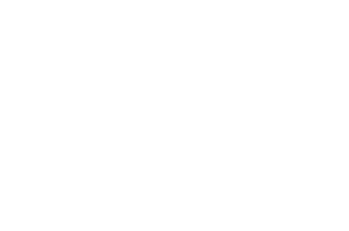

In [35]:

path='Downloads/set3/*.png'
k=4

ti_data,dat=getImageData(path)
    
ti_data = np.squeeze(ti_data)

ti_split=splitting(ti_data)
ti_split=np.array(ti_split)
ti_split=np.reshape(ti_split,(n,64,8,8))

ti_m=np.zeros((n,64))
ti_sd=np.zeros((n,64))
ti_sk=np.zeros((n,64))
wt=[0.33334,0.33334,0.33334]

dis_cm=cm_dis(ti_split)
scores_cm=list(dis_cm.values())
sc_array=np.array(scores_cm)
sc_array_cm=stats.zscore(sc_array)#finds z score of array



dis_elbp=elbp_dis(ti_data)
scores_elbp=list(dis_elbp.values())
sc_array_elbp=np.array(scores_elbp)
sc_array_elbp=stats.zscore(sc_array_elbp)#finds z score of array


dis_hog=hog_dis(ti_data)
scores_hog=list(dis_hog.values())
sc_array_hog=np.array(scores_hog)
sc_array_hog=stats.zscore(sc_array_hog)#finds z score of array


final={}
j=0
for i in range(n):
    
    
    final[dat[i]]=(sc_array_cm[i]*0.1)+(sc_array_elbp[i]*0.4)+(sc_array_hog[i]*0.5)
    
    j=j+1
k_final=dict(sorted(final.items(), key=lambda x: x[1])[1:5])#print top 4 images scores and path
print(k_final)


